### Representing entities as nodes

In [4]:
import pickle
import numpy as np
import pandas as pd
import networkx as nx
from pathlib import Path
import matplotlib.pyplot as plt

possible_sents = ["positive", "negative", "neutral"]

with open(Path("cache") / "entties.dict.pkl", "rb") as f:
    entities = pickle.load(f)

In [5]:
# Creating a graph and adding nodes, and their edges
G = nx.Graph()

for ent, data in list(entities.items()):
    if ent not in G.nodes:
        G.add_node(ent)

    for i, sent in enumerate(possible_sents):
        G.nodes[ent][sent] = data[sent]

        G.add_weighted_edges_from([(ent, k, v) for k, v in data["connections"][i].items()], sent)

In [10]:
n_conns = {i: sum([G.nodes[i][sent] for sent in possible_sents]) for i in G.nodes}
idx_top_10k = np.argsort([size for n, size in n_conns.items()])
top_10k_names = np.array([name for name, size in n_conns.items()])[idx_top_10k][:-10000:-1]

pd.Series(top_10k_names).to_pickle(Path("cache") / "top_10k_names.series.pkl")
pd.Series(top_10k_names)

0                                russia
1                               armenia
2                         united states
3                            azerbaijan
4                                turkey
                     ...               
9994                     nuclear powers
9995    rear admiral mark c. montgomery
9996                       amitav ghosh
9997                        kim yo jong
9998                   mark hoplamazian
Length: 9999, dtype: object

In [9]:
# give initial size for the subgraph
node_sizes = [
    (i, 40 + np.float_power(2 + sum([G.nodes[i][sent] for sent in possible_sents]), 0.9))
    for i in G.nodes if all([sent in G.nodes[i] for sent in possible_sents])
]

[56945, 56945, 56945]


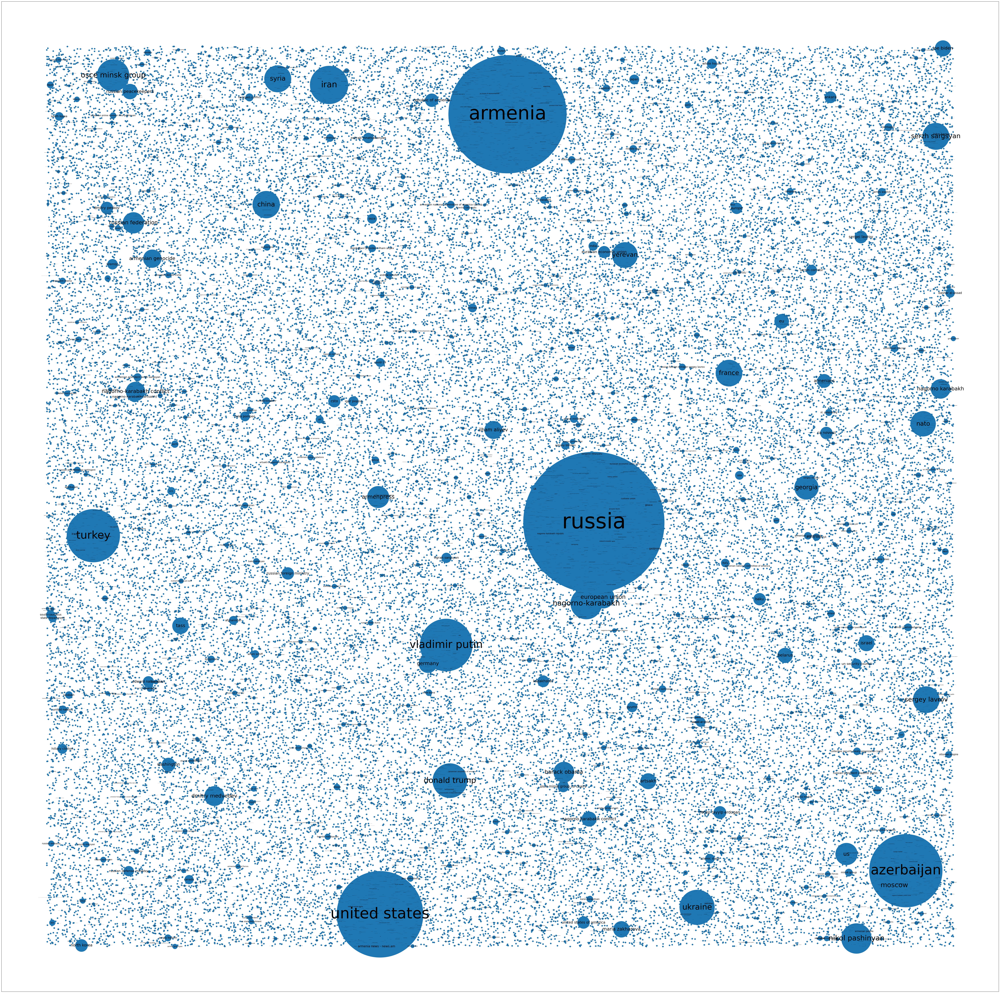

In [6]:
plt.figure(figsize=(90,90))

subgraph = G.subgraph([name for name, size in node_sizes])

# scale the sizes exponentially
node_sizes = [
    (i, 40 + np.float_power(2 + sum([subgraph.nodes[i][sent] for sent in possible_sents]), 1.4))
    for i in subgraph.nodes
]

pos = nx.random_layout(subgraph)

print([len(i) for i in [subgraph, pos, node_sizes]])

# draw the nodes with corresponding size
nx.draw_networkx_nodes(
    subgraph,
    pos,    
    node_size=[size for name, size in node_sizes]
)

# draw the names of the entities
for node in subgraph.nodes:
    size = np.float_power(sum([subgraph.nodes[node][sent] for sent in possible_sents]), 0.5)
    nx.draw_networkx_labels(subgraph, pos, {node: node}, int(size))

plt.savefig("graph3.svg", dpi=20)